### Integrating CSV files with geojson files.

In [1]:
# import necessary libraries.
import plotly.express as px
import geopandas as gpd
import numpy as np
import pandas as pd
import os
print("Imports successful!")

Imports successful!


In [2]:
print(os.getcwd()) # check at the working directory.

C:\Users\user\Documents\Kenya Secondary Schools Enrollment


In [3]:
# Load attribute file
attr_file = pd.read_csv(f"{os.getcwd()}//Data//SecondarySchoolsEnrollment.csv") 
attr_file.tail()

attr_file = attr_file.sort_values(ascending=True, by='% Transition Rate')
attr_file.head()

,County,Number of Students Selected,Number of Students Transitioned,Number of Students not yet transitioned,Total,% Transition Rate,% Failed Transition
9,Kajiado,30239,19313,10926,30239,63.867853,36.132147
32,Narok,37070,26866,10204,37070,72.473698,27.526302
8,Isiolo,4834,3707,1127,4834,76.685974,23.314026
13,Kilifi,33839,26827,7012,33839,79.278347,20.721653
18,Kwale,19015,15373,3642,19015,80.846700,19.153300


In [4]:
# Load vector file
vect_file = gpd.read_file(f"{os.getcwd()}//Data//kenya_counties.GeoJSON")
vect_file.tail()

,GID_0,Name,GID_1,County,Type,County_No,geometry
42,KEN,Kenya,KEN.5_1,Elgeyo Marakwet,County,28,"MULTIPOLYGON (((35.58806 0.17453, 35.58784 0.1..."
43,KEN,Kenya,KEN.6_1,Embu,County,14,"MULTIPOLYGON (((37.30928 -0.14896, 37.30914 -0..."
44,KEN,Kenya,KEN.7_1,Garissa,County,7,"MULTIPOLYGON (((40.43329 -1.93512, 40.41827 -1..."
45,KEN,Kenya,KEN.8_1,Homa Bay,County,43,"MULTIPOLYGON (((34.48337 -0.79247, 34.48297 -0..."
46,KEN,Kenya,KEN.9_1,Isiolo,County,11,"MULTIPOLYGON (((38.56964 -0.01509, 38.56928 -0..."


In [5]:
# Check at the datatype of both files
type(vect_file)
type(attr_file)

pandas.core.frame.DataFrame

In [6]:
# Build a function to merge the two files
def attr_merge():
    """
    This function merges two files, that is spatial and 
    aspatial. It is a fuction for attribute join only
    """
    attr_file = pd.read_csv(f"{os.getcwd()}//Data//SecondarySchoolsEnrollment.csv") # reading csv file
    vect_file = gpd.read_file(f"{os.getcwd()}//Data//kenya_counties.GeoJSON") # breading spatial data
    kenya_Sch_trans = attr_file.merge(vect_file, on='County')
    return kenya_Sch_trans
merged = attr_merge()

In [7]:
merged.tail()

,County,Number of Students Selected,Number of Students Transitioned,Number of Students not yet transitioned,Total,% Transition Rate,% Failed Transition,GID_0,Name,GID_1,Type,County_No,geometry
42,Turkana,11674,11612,62,11674,99.468905,0.531095,KEN,Kenya,KEN.43_1,County,23,"MULTIPOLYGON (((36.56896 2.06163, 36.56909 2.0..."
43,Uasin Gishu,39434,34418,5016,39434,87.280012,12.719988,KEN,Kenya,KEN.44_1,County,27,"MULTIPOLYGON (((35.58659 0.03784, 35.58565 0.0..."
44,Vihiga,21874,19841,2033,21874,90.705861,9.294139,KEN,Kenya,KEN.45_1,County,38,"MULTIPOLYGON (((34.74657 -0.01694, 34.74632 -0..."
45,Wajir,8070,7908,162,8070,97.992565,2.007435,KEN,Kenya,KEN.46_1,County,8,"MULTIPOLYGON (((40.99223 0.61325, 40.99220 0.6..."
46,West Pokot,19525,16773,2752,19525,85.905250,14.094750,KEN,Kenya,KEN.47_1,County,24,"MULTIPOLYGON (((35.47385 1.00621, 35.47345 1.0..."


In [8]:
merged.shape

(47, 13)

In [9]:
type(merged) # checking datatype of merged files

pandas.core.frame.DataFrame

### Writing as a GeoJson File.

In [10]:
# A function of writing it to a file
def writeFile():
    """
    This function write the merged files as
    a Geojson file
    """
    #converting to geodataframe.
    gdf = gpd.GeoDataFrame(merged, geometry='geometry')
    # write useing geojson driver
    return gdf.to_file("KC_SCH_Enrol.geojson", driver='GeoJSON')
    

writtenFile = writeFile() # Calling the function

## Developing Kenyan Counties Form One (2024) Secondary Schools Transition Dashboard
A picture is worth a thousand words. Data visuals disclose many information that tabular data can't. A visualized plot provides just as much value. It does this by providing a different look at tabular data, perhaps in the form of simple line charts, histogram distribution and more elaborate pivot charts. In this section, I'm developing an interactive web dashboard, that is user friendly. But wait, before this dashboard is developed, I need to note the following:

    i. I need to perform an Exploratory Data Analysis. This will enable me to gain data understanding.
    ii.I need to identify key metrics for tracking what matters such as County with the highest transion rate.
    iii.I need to decide on charts to best visualize key metrics
    iv.I need to group related metrics together.
    v.I need to use clear and concise labels to describe my metrics.

### Exploratory Data Analysis (EDA).

EDA is an iterative process of data understanding that entails asking and answering questions through investigative work of analyzing the data. In essence my dashboard starts as a blank canvas and EDA provides a pragmatic approach for coming up with compelling data visuals that tells a story.

In [11]:
# import necessary library.
import geopandas as gpd
import os
import pandas as pd

# Load in the file
in_file = gpd.read_file(f"{os.getcwd()}//KC_SCH_Enrol.GeoJSON")
in_file.head()

,County,Number of Students Selected,Number of Students Transitioned,Number of Students not yet transitioned,Total,% Transition Rate,% Failed Transition,GID_0,Name,GID_1,Type,County_No,geometry
0,Baringo,24146,20581,3565,24146,85.235650,14.764350,KEN,Kenya,KEN.1_1,County,30,"MULTIPOLYGON (((35.67241 1.07306, 35.67228 1.0..."
1,Bomet,39383,37218,2165,39383,94.502704,5.497296,KEN,Kenya,KEN.2_1,County,36,"MULTIPOLYGON (((35.26193 -1.01562, 35.26177 -1..."
2,Bungoma,65472,53871,11601,65472,82.280975,17.719025,KEN,Kenya,KEN.3_1,County,39,"MULTIPOLYGON (((34.45476 0.47293, 34.45463 0.4..."
3,Busia,39444,36254,3190,39444,91.912585,8.087415,KEN,Kenya,KEN.4_1,County,40,"MULTIPOLYGON (((34.24632 0.31446, 34.24586 0.3..."
4,Elgeyo Marakwet,24854,21747,3107,24854,87.498994,12.501006,KEN,Kenya,KEN.5_1,County,28,"MULTIPOLYGON (((35.58806 0.17453, 35.58784 0.1..."


In [12]:
# Checking at the shape of the tabular data
print(f"The data has a dimension of {in_file.shape}, rows and columns respectively.\n")

# Descriptive statitics
print(f"Below are the descriptive statistics of the data: \n{in_file.describe()}")

The data has a dimension of (47, 13), rows and columns respectively.

Below are the descriptive statistics of the data: 
       Number of Students Selected  Number of Students Transitioned  \
count                    47.000000                        47.000000   
mean                  29669.021277                     26982.659574   
std                   17013.147263                     16058.727845   
min                    4834.000000                      3707.000000   
25%                   16361.500000                     14515.500000   
50%                   29532.000000                     22857.000000   
75%                   39439.000000                     36736.000000   
max                   75539.000000                     72562.000000   

       Number of Students not yet transitioned         Total  \
count                                47.000000     47.000000   
mean                               2686.382979  29669.042553   
std                                2647.944901 

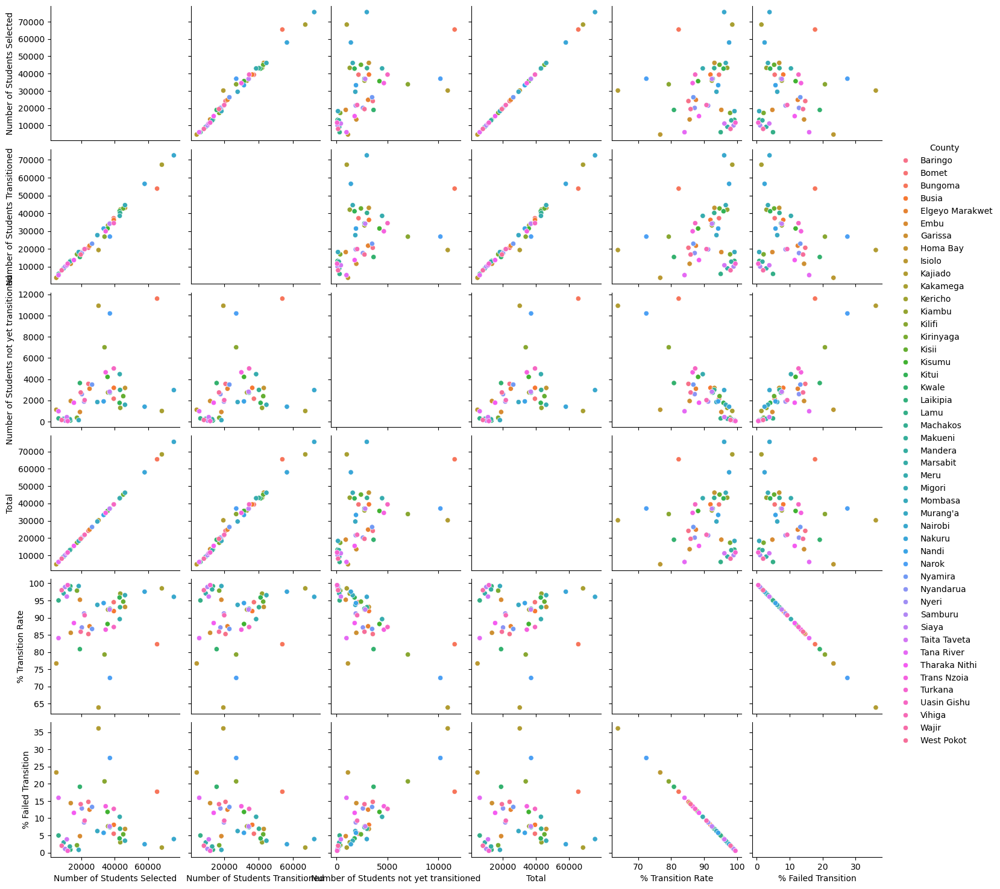

In [13]:
# Distribution plots
import seaborn as sns
import matplotlib.pyplot as plt

sns.pairplot(in_file, hue="County")
plt.show()

In [14]:
import folium

data = in_file

m = folium.Map(location=(0.18, 37.91), zoom_start=6, tiles="cartodb positron")
folium.GeoJson(in_file).add_to(m)
m

In [15]:
import plotly.express as px
import pandas as pd
import geopandas as gpd
print("Import successfull!")

Import successfull!


<Axes: >

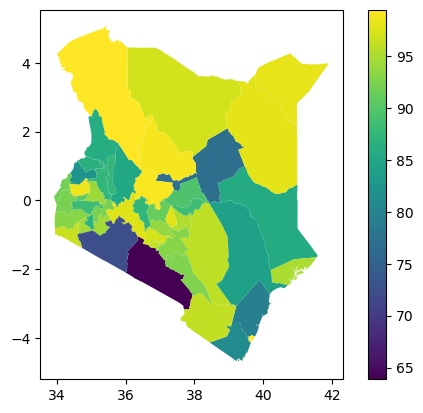

In [16]:
# Plot by % Transition Rate
in_file.plot(column="% Transition Rate", legend=True)

<Axes: >

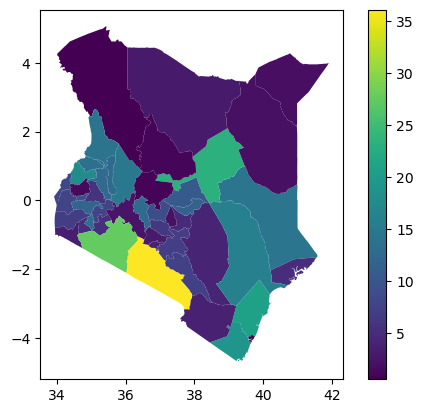

In [17]:
# Plot by failed transition rate
in_file.plot(column="% Failed Transition", legend=True)

In [18]:
# What is the minimum transition rate?
df = pd.DataFrame(in_file)

df1 = df.copy()
df1 = df1["% Transition Rate"]
df1 = pd.DataFrame(df1)
print(f"The minimum transition rate: {int(df1.min())}%")
# if df["% Transition Rate"].min

The minimum transition rate: 63%


C:\Users\user\AppData\Local\Temp\ipykernel_3424\1864703180.py:7: FutureWarning: Calling int on a single element Series is deprecated and will raise a TypeError in the future. Use int(ser.iloc[0]) instead
  print(f"The minimum transition rate: {int(df1.min())}%")


In [19]:
# What is the maximum transition rate?
print(f"The maximum transition rate: {int(df1.max())}%")

The maximum transition rate: 99%


C:\Users\user\AppData\Local\Temp\ipykernel_3424\586124936.py:2: FutureWarning: Calling int on a single element Series is deprecated and will raise a TypeError in the future. Use int(ser.iloc[0]) instead
  print(f"The maximum transition rate: {int(df1.max())}%")


In [20]:
df = pd.DataFrame(in_file[["County", "% Transition Rate", "% Failed Transition"]])
type(df)

pandas.core.frame.DataFrame

In [21]:
sorted_df = df.sort_values(ascending=True, by='% Transition Rate')
sorted_df.head()

,County,% Transition Rate,% Failed Transition
9,Kajiado,63.867853,36.132147
32,Narok,72.473698,27.526302
8,Isiolo,76.685974,23.314026
13,Kilifi,79.278347,20.721653
18,Kwale,80.846700,19.153300


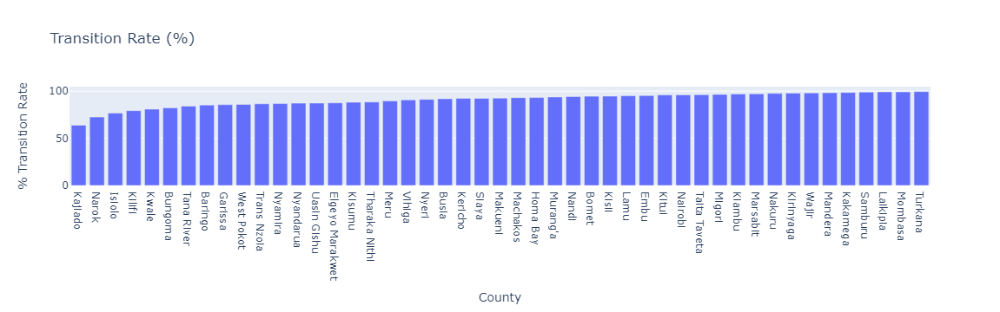

In [28]:
# # Create a plot, bar graph.
# import streamlit as st
# st.bar_chart(sorted_df, x="County", y="% Transition Rate", color="% Transition Rate")
import plotly.express as px
data = sorted_df
fig = px.bar(data, x='County', y='% Transition Rate', title='Transition Rate (%)')
fig.show()

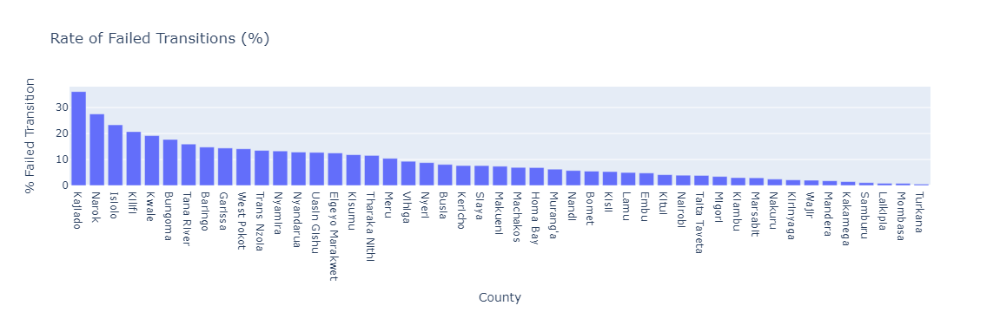

In [29]:
fig = px.bar(data, x='County', y='% Failed Transition', title='Rate of Failed Transitions (%)')
fig.show()

In [30]:
# geo_data = gpd.GeoDataFrame(in_file.columns[6:-1])
# print(type(geo_data))

geo_data = gpd.GeoDataFrame(in_file[["County", "GID_0", "Name", "Type", "County_No", "geometry"]])

In [31]:
geo_data = geo_data.sort_values(by='County')
geo_data.head()

,County,GID_0,Name,Type,County_No,geometry
0,Baringo,KEN,Kenya,County,30,"MULTIPOLYGON (((35.67241 1.07306, 35.67228 1.0..."
1,Bomet,KEN,Kenya,County,36,"MULTIPOLYGON (((35.26193 -1.01562, 35.26177 -1..."
2,Bungoma,KEN,Kenya,County,39,"MULTIPOLYGON (((34.45476 0.47293, 34.45463 0.4..."
3,Busia,KEN,Kenya,County,40,"MULTIPOLYGON (((34.24632 0.31446, 34.24586 0.3..."
4,Elgeyo Marakwet,KEN,Kenya,County,28,"MULTIPOLYGON (((35.58806 0.17453, 35.58784 0.1..."


### Choropleth Mapping.

In [32]:
m = folium.Map(location=[0.18, 37.91], zoom_start=6) # initializing folium map

folium.Choropleth(
    geo_data=geo_data,
    name="Form One Transition Rates (%)",
    data=df,
    columns=["County", "% Transition Rate"],
    key_on="feature.properties.County",
    fill_opacity=0.7,
    fill_color="YlGn",
    line_opacity=0.2,
    legend_name="% Transitions"
).add_to(m)

cp = folium.Choropleth(
    geo_data=geo_data,
    name="Form One Failed Transition Rates (%)",
    data=df,
    columns=["County", "% Failed Transition"],
    key_on="feature.properties.County",
    fill_opacity=0.7,
    fill_color="Reds",
    line_opacity=0.2,
    legend_name="% Transitions"
    
).add_to(m)

# # creating County indexed version of the dataframe so we can lookup values
# df_indexed = df.set_index('County')

# # Looping through geojson object and adding a new property(% Transition Rate)
# for s in cp.geojson.data["features"]:
#     s['properties']['Transition Rate'] = df_indexed.loc[s['County_No'], '% Transition Rate']
#     folium.GeoJsonTooltip(['name', 'Transition Rate', 'Failed Transition Rate']).add_to(cp.geojson)
folium.LayerControl().add_to(m)
m

In [27]:
# cp.geojson.data

In [45]:
outfp = f"{os.getcwd()}//Data//choropleth_map.html"
m.save(outfp)

In [ ]:
(f"{os.getcwd()}//Data//SecondarySchoolsEnrollment.csv")